# Themes

## Load cuXfilter and data

In [1]:
from cuXfilter import charts
import cuXfilter
from bokeh import palettes
cux_df = cuXfilter.DataFrame.from_arrow('../../../data/146M_predictions_v2.arrow')

## Declare charts

In [2]:
#tile provider for choropleth map
from bokeh.tile_providers import get_provider as gp
tile_provider = gp('CARTODBPOSITRON')
tile_provider_dark = gp('STAMEN_TONER')

chart1 = charts.bokeh.choropleth(x='zip', y='delinquency_12_prediction', aggregate_fn='mean', 
                                  geoJSONSource = 'https://raw.githubusercontent.com/rapidsai/cuxfilter/master/javascript/demos/GTC%20demo/src/data/zip3-ms-rhs-lessprops.json',
                                  data_points=1000,
                                  nan_color='white', tile_provider= tile_provider)
chart2 = charts.bokeh.bar('borrower_credit_score')
chart_widget = charts.panel_widgets.multi_select('dti')

#create a list of charts
charts_list = [chart_widget, chart1, chart2]

## Themes Types

### 1. Light

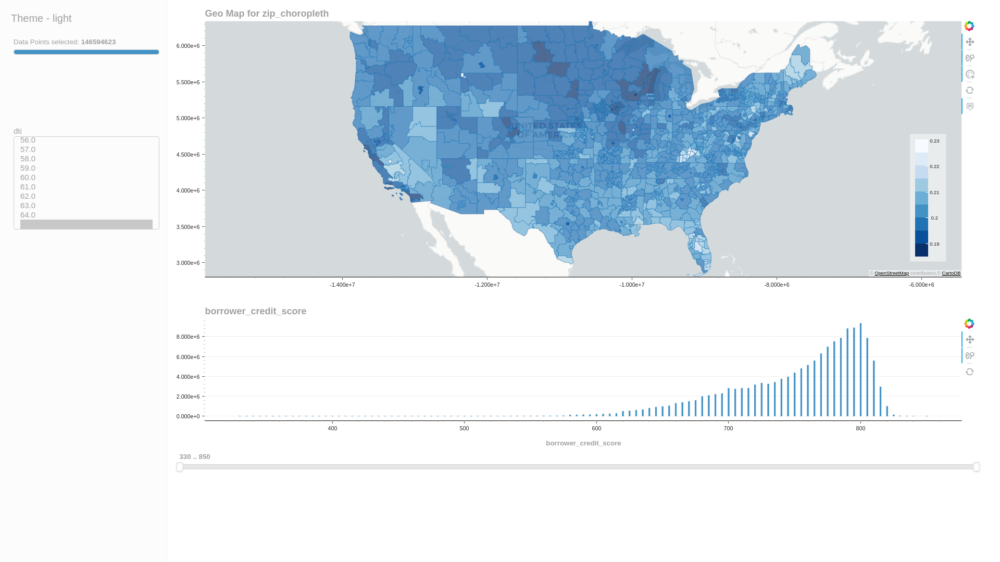

In [3]:
d = cux_df.dashboard(charts_list, layout=cuXfilter.layouts.feature_and_base, theme=cuXfilter.themes.light, title="Theme - light")
await d.preview()

### 2. Rapids

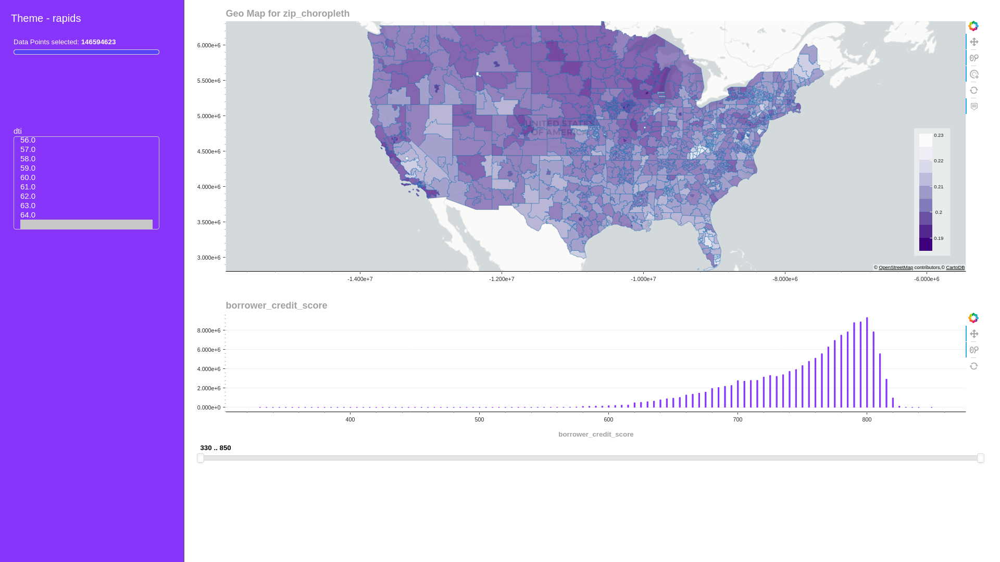

In [4]:
d = cux_df.dashboard(charts_list, layout=cuXfilter.layouts.feature_and_base, theme=cuXfilter.themes.rapids, title="Theme - rapids")
await d.preview()

### 3. Dark

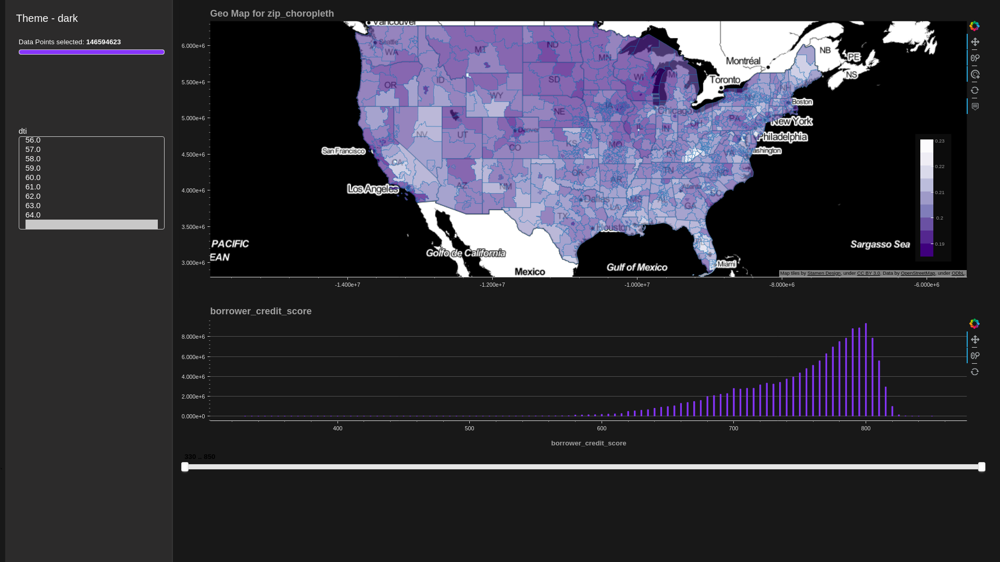

In [5]:
chart1.tile_provider = tile_provider_dark
d = cux_df.dashboard(charts_list, layout=cuXfilter.layouts.feature_and_base, theme=cuXfilter.themes.dark, title="Theme - dark")
await d.preview()